<a href="https://colab.research.google.com/github/grellert/curso-computer-vision/blob/main/Curso_CV_Grellert_Semana_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Curso de Visão Computacional
- Autor: Mateus Grellert (INF/UFRGS)
- Contato: mateus.grellert@inf.ufrgs.br



# Detecção de Bordas e de Saliência
- Uma borda é uma região da imagem que normalmente representa o início ou o fim de um objeto.
- Se considerarmos uma imagem no domínio do pixel, uma borda acontece quando temos que temos uma variação elevada nos valores de pixels vizinhos.
- A intensidade e a direção desta variação pode ser obtida através da análise do gradiante (operador $\nabla$) desta imagem.
- A obtenção da intensidade do gradiante é obtida através de filtros de **convolução**.
<center> <img src = https://miro.medium.com/v2/resize:fit:1052/0*jLoqqFsO-52KHTn9.gif width=350 /> </center>

- Vamos explorar estes conceitos e alguns métodos clássicos de detecção de bordas abaixo. Vamos utilizar principalmente as bibliotecas **skimage** e **OpenCV**.

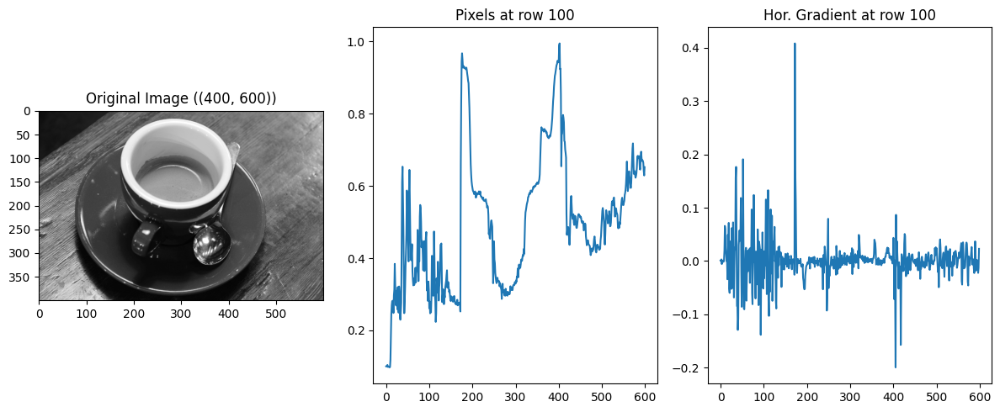

In [ ]:
import skimage.data
import numpy as np
import matplotlib.pyplot as plt

img = skimage.data.coffee()
# opening the black_circle image for border visualization
#img = skimage.io.imread('black_circle.jpg')

img_gray = skimage.color.rgb2gray(img)

plt.figure(figsize = (12,5))
plt.subplot(1,3,1)
plt.title(f'Original Image ({img_gray.shape})')
plt.imshow(img_gray, cmap = 'gray')

plt.subplot(1,3,2)
row_idx = 100
plt.plot(img_gray[row_idx, :])
plt.title(f'Pixels at row {row_idx}')

plt.subplot(1,3,3)
plt.plot(img_gray[row_idx, 1:] - img_gray[row_idx, :-1] )
plt.title(f'Hor. Gradient at row {row_idx}')

plt.tight_layout()
plt.show()


## Métodos clássicos
- Vamos agora aplicar a operação de convolução para aplicar o detector de Roberts, que usa kernels 2D. Para isso, vamos utilizar o método **scipy.signal.convolve**.
- Como a convolução pode gerar saídas com tamanho menor do que a entrada, podemos aplicar **padding** automaticamente com esse método através do parâmetro **mode=** *\"same\"*.

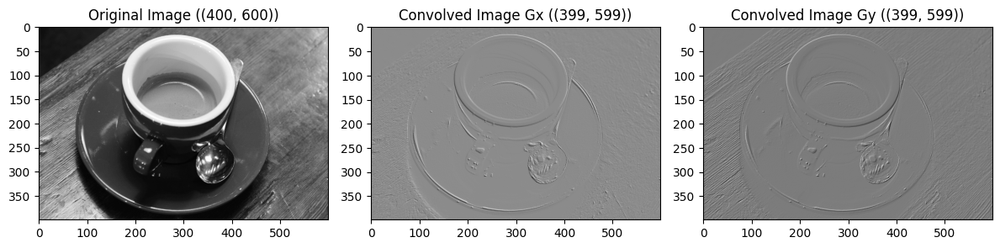

In [ ]:
import scipy.ndimage
import scipy.signal

# perform 2D convolution using Robert kernels
rob_gx = np.array([[ 0,1],
                   [-1,0]])

rob_gy = np.array([[ 1,0],
                   [0,-1]])

#convolved_image = scipy.ndimage.convolve(astronaut_gray, kernel, mode = 'constant', cval = 0)
img_grad_x = scipy.signal.convolve(img_gray, rob_gx, mode = 'valid').astype(np.float64)
img_grad_y = scipy.signal.convolve(img_gray, rob_gy, mode = 'valid').astype(np.float64)

# plot results
plt.figure(figsize = (12,5))
plt.subplot(1,3,1)
plt.title(f'Original Image ({img_gray.shape})')
plt.imshow(img_gray, cmap = 'gray')
plt.subplot(1,3,2)
plt.title(f'Convolved Image Gx ({img_grad_x.shape})')
ax = plt.imshow(img_grad_x, cmap = 'gray')
plt.subplot(1,3,3)
plt.title(f'Convolved Image Gy ({img_grad_y.shape})')
ax = plt.imshow(img_grad_y, cmap = 'gray')

plt.tight_layout()
plt.show()

- Vamos também calcular a magnitude dos gradiantes considerando a intensidade nas direções horizontais e verticais. A imagem do lado direito representa o histograma dos valores calculados.

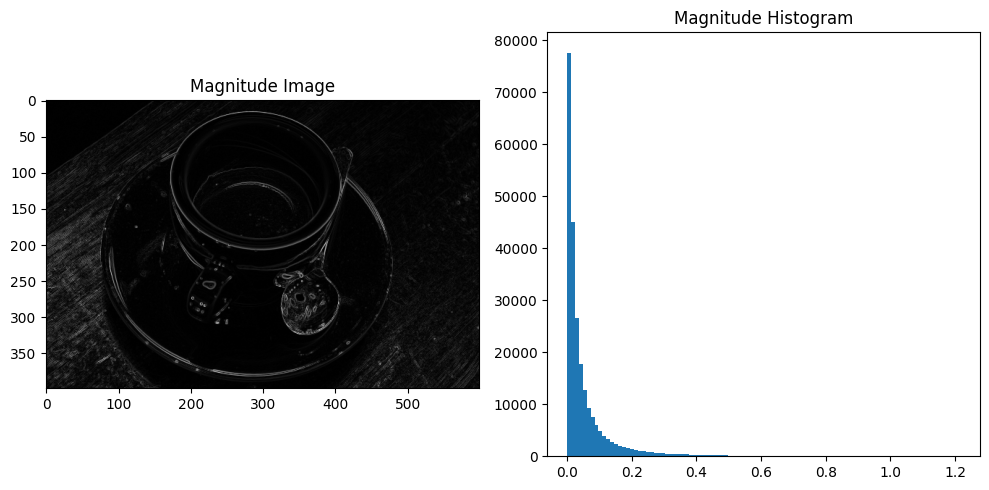

In [ ]:

plt.figure(figsize = (10,5))

plt.subplot(1,2,1)

mag_img = np.sqrt(img_grad_x**2 + img_grad_y**2).astype(np.float64)
plt.imshow(mag_img, cmap = 'gray')
plt.title('Magnitude Image')

plt.subplot(1,2,2)
plt.hist(mag_img.ravel(), bins = 100)
plt.title('Magnitude Histogram')

plt.tight_layout()

plt.show()

- Com a informação das magnitudes, podemos criar uma versão simplificada (quantizada) da imagem. A forma mais quantizada de todas é a **binarização**, que transforma todos os pixels abaixo de um certo limiar (*threshold*) em $0$, e todos acima em $1$.
- Determinar o valor de threshold pode ser feito através de medidas de média e dispersão, mas existe um método bastante eficiente chamado **método de Otsu**, que descobre o melhor threshold de forma a minimizar a variância interna das partes 0 e 1 da imagem.

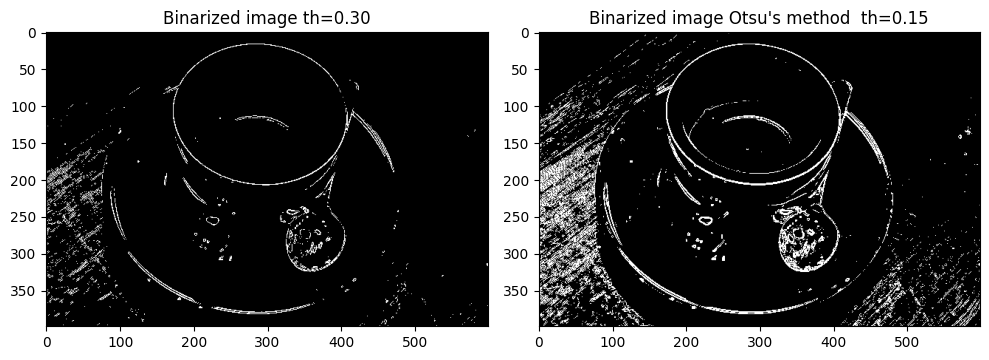

In [ ]:
from skimage.filters import threshold_otsu

plt.figure(figsize = (10,5))

th = mag_img.mean() + 3*mag_img.std()

mag_img_bin = mag_img.copy()
mag_img_bin[mag_img_bin < th] = 0
mag_img_bin[mag_img_bin > th] = 1

# binarzation using Otsu's method
th_otsu = threshold_otsu(mag_img)
mag_img_bin_otsu = mag_img > th_otsu

plt.subplot(1,2,1)
plt.imshow(mag_img_bin, cmap = 'gray')
plt.title(f'Binarized image th={th:.2f}')

plt.subplot(1,2,2)
plt.imshow(mag_img_bin_otsu, cmap = 'gray')
plt.title(f'Binarized image Otsu\'s method  th={th_otsu:.2f}')

plt.tight_layout()

plt.show()



- Alguns métodos também se baseiam na direção do gradiente. Para visualizar as direções, podemos usar o método **pyplot.quiver**, como pode ser visto no código abaixo.

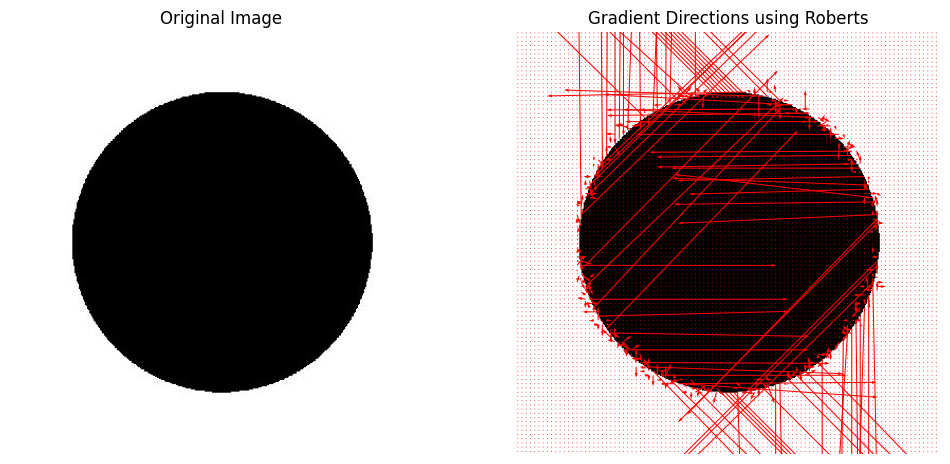

In [ ]:
import cv2
# Create a grid of coordinates
step = 4
x = np.arange(0, img_gray.shape[1], step)
y = np.arange(0, img_gray.shape[0], step)
X, Y = np.meshgrid(x, y)


# Plotting
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img_gray, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Gradient Directions using Roberts')
plt.imshow(img_gray, cmap='gray')
plt.quiver(X, Y, img_grad_x[::step,::step], img_grad_y[::step,::step], color='red', angles='xy', scale_units='xy')
plt.axis('off')

plt.show()


- O filtro de Roberts tem como limitação sensibilidade ao ruído. Uma alternativa é o **filtro de Sobel**, que possui baixo custo computacional e é menos sensível ao ruído devido ao uso de kernels maiores.

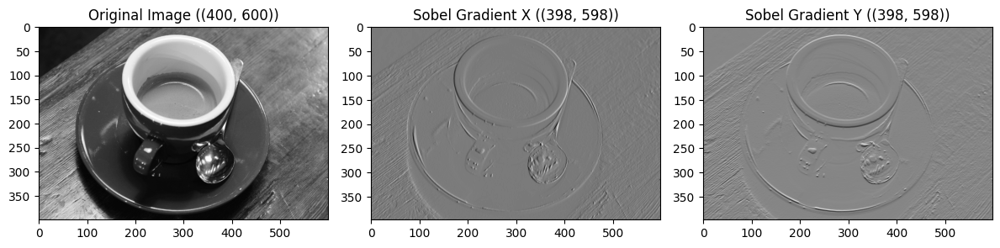

In [ ]:
# prompt: compute the Sobel gradient in X and Y, plot the image and the Sobel components

import skimage.data
import skimage.io
import skimage.color
import skimage.filters

import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage
import scipy.signal
import cv2

img = skimage.io.imread('black_circle.jpg')
img = skimage.data.coffee()

img_gray = skimage.color.rgb2gray(img)

sobel_x = np.array([[-1, 0, 1],
                   [-2, 0, 2],
                   [-1, 0, 1]])

sobel_y = np.array([[1, 2, 1],
                   [0, 0, 0],
                   [-1, -2, -1]])

img_sobel_x = scipy.signal.convolve(img_gray, sobel_x, mode='valid').astype(np.float64)
img_sobel_y = scipy.signal.convolve(img_gray, sobel_y, mode='valid').astype(np.float64)

plt.figure(figsize=(12, 5))
plt.subplot(1, 3, 1)
plt.title(f'Original Image ({img_gray.shape})')
plt.imshow(img_gray, cmap='gray')

plt.subplot(1, 3, 2)
plt.title(f'Sobel Gradient X ({img_sobel_x.shape})')
plt.imshow(img_sobel_x, cmap='gray')

plt.subplot(1, 3, 3)
plt.title(f'Sobel Gradient Y ({img_sobel_y.shape})')
plt.imshow(img_sobel_y, cmap='gray')

plt.tight_layout()
plt.show()


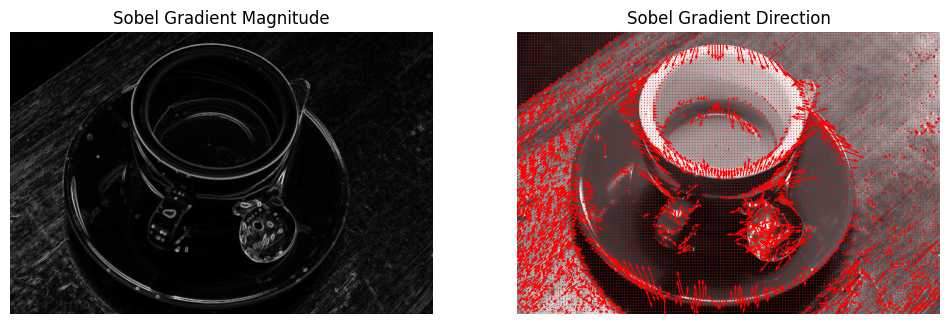

In [ ]:
# prompt: compute the Sobel gradient magnitude and direction. Plot the Sobel direction using quiver plots

import matplotlib.pyplot as plt
import numpy as np
mag_img = np.sqrt(img_sobel_x**2 + img_sobel_y**2).astype(np.float64)
dir_img = np.arctan2(img_sobel_y, img_sobel_x)

# Create a grid of coordinates
step = 4
x = np.arange(0, img_gray.shape[1], step)
y = np.arange(0, img_gray.shape[0], step)
X, Y = np.meshgrid(x, y)

# Plotting
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Sobel Gradient Magnitude')
plt.imshow(mag_img, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Sobel Gradient Direction')
plt.imshow(img_gray, cmap='gray')
plt.quiver(X, Y, img_sobel_x[::step,::step], img_sobel_y[::step,::step], color='red', angles='xy', scale_units='xy')
plt.axis('off')

plt.show()


## Método de Canny

- Esse é um dos métodos mais utilizados para detecção de bordas, devido à sua eficência. O método de Canny realiza os seguintes (visualização na [Wikipedia](https://en.wikipedia.org/wiki/Canny_edge_detector)):
 - Suavização da imagem através de um filtro Gaussiano (com desvio padrão = $\sigma$)
 - Cálculo de gradientes (normalmente com Sobel)
 - Non-maximum-supression: dada uma janela, conserva somente o pixel de maior valor. Essa etapa geras bordas mais finas.
 - Categorização de bordas com dois valores de limiar ($th_{low}$ a $th_{high}$): dado um valor de intensidade $v$, aplimos a seguinte regra: se $v < th_{low}$ o pixel de borda é eliminado, se $th_{high} < v < th_{low}$, o pixel é consirado borda fraca e passa para a próxima etapa. Se $v > th_{low}$. O pixel é consirado de borda forte e mantido.
 - Histerese: técnica que conecta pixels vizinhos, de forma a facilitar a criação de objetos fechados. Nessa etapa, os pixels fracos e fortes são considerados para possivelmente conectar regiões contínuas.

- Vamos realizar alguns testes no Canny, utilizando estes três principais parâmetros: $\sigma$, $th_{low}$ e $th_{high}$.

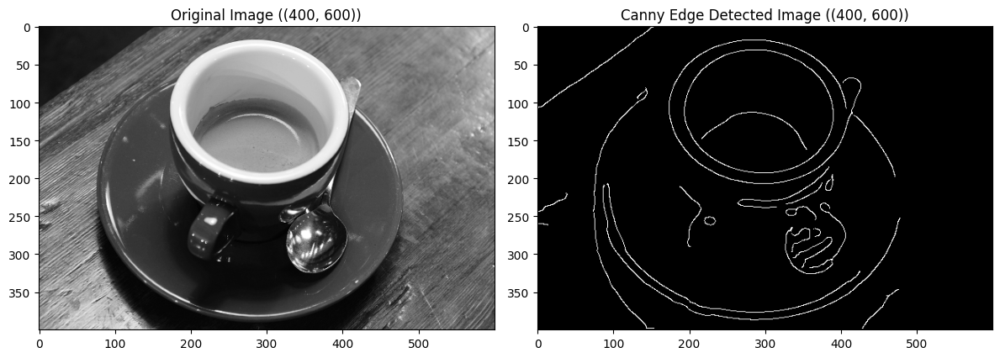

In [ ]:
# @title Parâmetros { run: "auto", form-width: "300px" }
# step by step: https://towardsdatascience.com/canny-edge-detection-step-by-step-in-python-computer-vision-b49c3a2d8123

# prompt: now do the same using Canny edge detector

import skimage.data
import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage
import scipy.signal
import cv2


sigma = 4 #@param
th_low = 0.0  #@param
th_high = 0.2  #@param
img = skimage.data.coffee()
#img = skimage.io.imread('black_circle.jpg')

img_gray = skimage.color.rgb2gray(img)
edges = skimage.feature.canny(img_gray, sigma=sigma, low_threshold=th_low, high_threshold = th_high)

plt.figure(figsize = (12,5))
plt.subplot(1,2,1)
plt.imshow(img_gray, cmap = 'gray')
plt.title(f'Original Image ({img_gray.shape})')
plt.subplot(1,2,2)
plt.imshow(edges, cmap = 'gray')
plt.title(f'Canny Edge Detected Image ({edges.shape})')

plt.tight_layout()
plt.show()


## Detecção de Saliência

- Detectar regiões salientes na imagem também é bastante importante, pois permite entender em que parte da imagem usuários vão dedicar mais atenção.
- Vamos avaliar o método definido Hou & Zhang (2007), baseado em análise estatísca sobre o domínio espectral (das frequências). Artigo [aqui](https://ieeexplore.ieee.org/document/4270292).


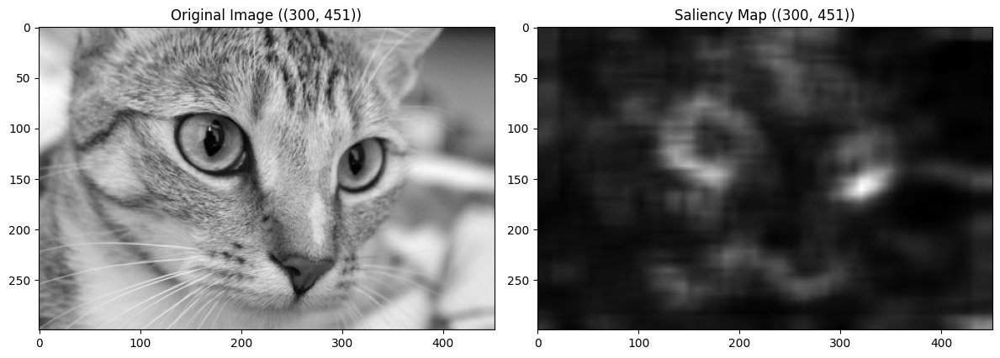

In [ ]:
# prompt: compute the saliency map of img_gray using openCV

import matplotlib.pyplot as plt
import cv2

img = skimage.data.cat()
if img.ndim == 3:
    img_gray = skimage.color.rgb2gray(img)
else:
    img_gray = img

# Create a saliency object
saliency = cv2.saliency.StaticSaliencySpectralResidual_create()
(success, saliencyMap) = saliency.computeSaliency(img_gray)

plt.figure(figsize = (12,5))
plt.subplot(1,2,1)
plt.imshow(img_gray, cmap = 'gray')
plt.title(f'Original Image ({img_gray.shape})')
plt.subplot(1,2,2)
plt.imshow(saliencyMap, cmap = 'gray')
plt.title(f'Saliency Map ({saliencyMap.shape})')

plt.tight_layout()
plt.show()


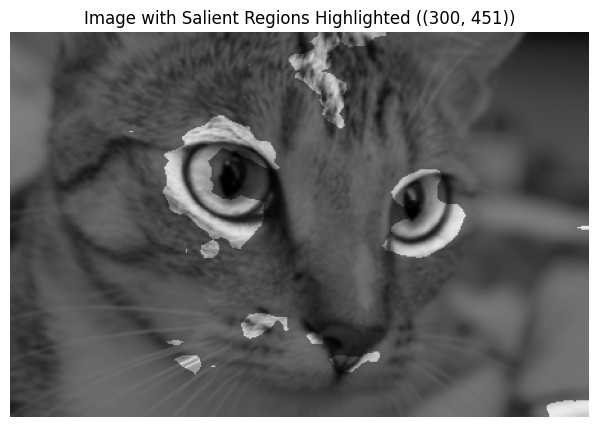

In [ ]:
# prompt: highlight the salient regions on the image

import matplotlib.pyplot as plt
import numpy as np
import cv2

# Create a copy of the original image
img_with_saliency = img_gray.copy()
th = 0.3

# Threshold the saliency map to highlight the most salient regions
_, thresholded_saliency_map = cv2.threshold(saliencyMap, th * np.max(saliencyMap), 255, cv2.THRESH_BINARY)

# Apply the saliency map as a mask to the original image
img_with_saliency[thresholded_saliency_map == 0] = 0

# Display the image with highlighted salient regions
plt.figure(figsize=(12, 5))

dst = np.ones_like(img_gray)


plt.imshow(img_with_saliency, cmap = 'gray')
plt.imshow(cv2.blur(img_gray, ksize=(3,3)), cmap = 'gray', alpha = 0.5)


plt.title(f'Image with Salient Regions Highlighted ({img_with_saliency.shape})')
plt.axis('off')
plt.show()


# Segmentação
- A detecção de bordas é bastante útil para encontrar possíveis limites de objetos na imagem, mas ela não vai muito além disso.
- As técnicas de segmentação têm um objetivo mais ambicioso: dividir a imagem em partições. A ideia é de que partições vão representar conceitos com significado (exemplo: objetos, fundo)
- Vamos começar avaliando uma técnica bem simples chamada de K-means clustering, a qual calcula clusters com base na intensidade dos pixels em cada de cor.
<center><img src=https://upload.wikimedia.org/wikipedia/commons/d/d5/Kmeans_animation.gif  /></center>

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


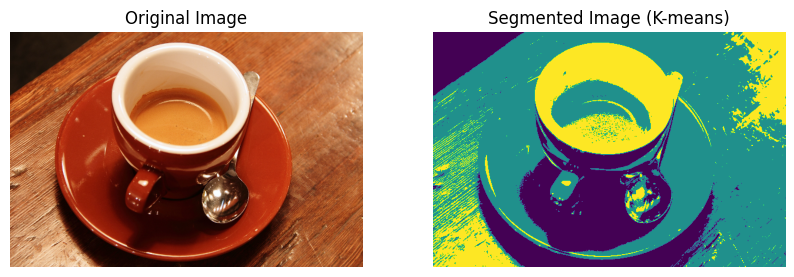

In [ ]:
# @title KMeans { run: "auto", form-width: "300px" }
# @title  { run: "auto" }
# @title  { run: "auto", form-width: "300px" }
# prompt: perform k-means segmentation over the coffee image from skimage

import skimage.data
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the coffee image
image = skimage.data.coffee()


# Reshape the image to a 1D array
image_2d = image.reshape((-1, 3))

# Perform K-means segmentation with k clusters
k = 3 # @param {type:"integer"}
kmeans = KMeans(n_clusters=k).fit(image_2d)

# Get the cluster labels
labels = kmeans.labels_

# Reshape the labels to a 2D array
labels_2d = labels.reshape(image.shape[:-1])

# Plot the original image and the segmented image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(labels_2d)
plt.title('Segmented Image (K-means)')
plt.axis('off')

plt.show()


- Como escolher o melhor valor de $k$? Não existe uma forma analítica, então contamos com heurísticas empíricas. Uma estratégia se chama **elbow method**, no qual computamos uma métrica para vários valores de $k$ e selecionamos o ponto de inflexão (quando a curva para de subir/descer de forma intensa).
- Vamos visualizar esse método a seguir, usando agora a imagem no espaço de cor HSV (hue, saturation, value of intensity).

In [ ]:
#SOURCE: https://medium.com/@muhammetbolat/image-segmentation-using-k-means-clustering-algorithm-and-mean-shift-clustering-algorithm-fb6ebe4cb761
# adapted by M. Grellert

import numpy as np
import pandas as pd
import cv2
import collections
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import filters
from skimage import util
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import MeanShift, estimate_bandwidth
import warnings
warnings.filterwarnings("ignore")


index = pd.MultiIndex.from_product(
    (*map(range, image.shape[:2]), ('r', 'g', 'b')),
    names=('row', 'col', None))
df_1 = pd.Series(image.flatten(), index=index)
df_1 = df_1.unstack()
df_1 = df_1.reset_index().reindex(columns=['col','row',   'r','g','b'])
df_1.head(10)


,col,row,r,g,b
0,0,0,21,13,8
1,1,0,21,13,9
2,2,0,20,11,8
3,3,0,21,13,11
4,4,0,21,14,8
5,5,0,21,14,6
6,6,0,22,14,9
7,7,0,22,14,8
8,8,0,23,15,9
9,9,0,23,15,9


In [ ]:
df_2 = df_1[['r', 'g', 'b']]
df_2.head(10)


,r,g,b
0,21,13,8
1,21,13,9
2,20,11,8
3,21,13,11
4,21,14,8
5,21,14,6
6,22,14,9
7,22,14,8
8,23,15,9
9,23,15,9


In [ ]:
nd_1 = MinMaxScaler(feature_range=(0, 1)).fit_transform(df_1)
nd_2 = MinMaxScaler(feature_range=(0, 1)).fit_transform(df_2)


In [ ]:
import plotly.express as px

import numpy as np
import plotly.graph_objects as go

# Convert nd_1/2 to HSV
nd_2_hsv = pd.DataFrame(skimage.color.rgb2hsv(nd_2), columns = ['h', 's', 'v'])

nd_1_hsv = pd.DataFrame(skimage.color.rgb2hsv(nd_2), columns = ['h', 's', 'v'])
nd_1_hsv["row"] = nd_1[:,0]
nd_1_hsv["col"] = nd_1[:,1]

fig = px.density_heatmap(nd_2_hsv, x="h", y="s", marginal_x="histogram", marginal_y="histogram")
fig.update_layout(width = 800, height = 500, margin = dict(l = 0, r = 0, b = 0, t = 0))
fig.show()



In [ ]:
import matplotlib.pyplot as plt

total_inertias_1 = [KMeans(n_clusters=i).fit(nd_1_hsv).inertia_ for i in range(2, 8)]
total_inertias_2 = [KMeans(n_clusters=i).fit(nd_2_hsv).inertia_ for i in range(2, 8)]



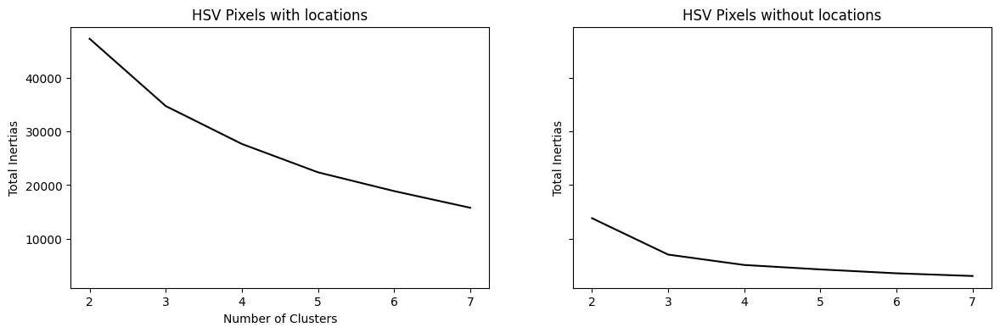

In [ ]:

fig, (ax1, ax2) = plt.subplots(1, 2, sharex='col', sharey='row', figsize=(14,4))
ax1.plot(range(2, 8), total_inertias_1, c='black')
ax1.set(ylabel='Total Inertias', xlabel='Number of Clusters', title='HSV Pixels with locations')
ax2.plot(range(2, 8), total_inertias_2, c='black')
ax2.set(ylabel='Total Inertias', title='HSV Pixels without locations');
plt.savefig('elbow_result.jpg')

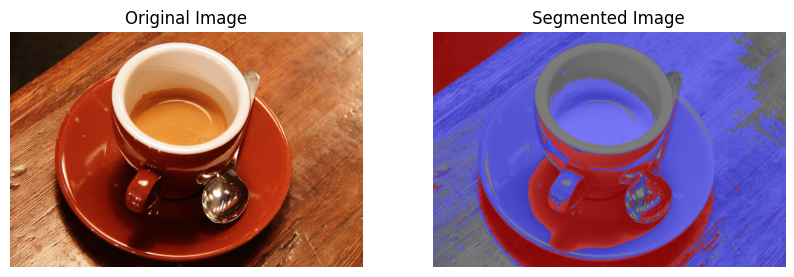

In [ ]:
# prompt: compute the k-means over the coffee image and plot the cluster segments as color overlays on the image using skimage label2rgb

import skimage.data
import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage
import scipy.signal
import cv2
import skimage.io
import skimage.color
import skimage.filters
import cv2
import skimage.feature
from sklearn.cluster import KMeans
import seaborn as sns
import pandas as pd
import collections
from skimage import filters
from skimage import util
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import MeanShift, estimate_bandwidth
import warnings

img = skimage.data.coffee()

# Reshape the image to a 1D array
image_2d = img.reshape((-1, 3))

# Perform K-means segmentation with k clusters
k = 3
kmeans = KMeans(n_clusters=k).fit(nd_2_hsv)

# Get the cluster labels
labels = kmeans.labels_

# Reshape the labels to a 2D array
labels_2d = labels.reshape(img.shape[:-1])

# Plot the original image and the segmented image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(skimage.color.label2rgb(labels_2d, img, alpha=0.5))
plt.title('Segmented Image')
plt.axis('off')

plt.show()


## MeanShift
- A técnica K-means acaba agrupando os pixels com base no seu valor, portanto os segmentos são muito mais voltados à semelhança de cor do que a uma noção real de objetos.
- Uma alternativa é gerar uma representação no espaço de features. Para isso, vamos usar a técnica backprojection. Esta técnica compara o histograma de uma imagem com outra (normalmente uma região de interesse - ROI). De forma a detectar padrões de intensidade similares. A probabilidade de cada pixel pertencer à ROI é então utilizada para gerar a imagem no espaço de features.

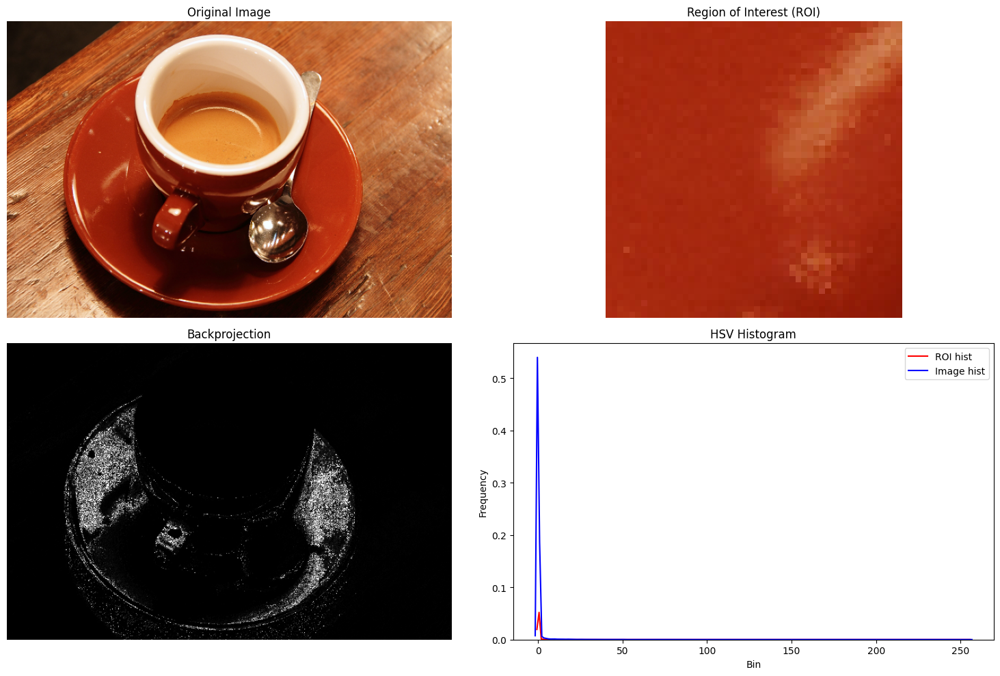

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def backprojection(image, roi_coords):
    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    # Extract ROI coordinates
    x1, y1, x2, y2 = roi_coords
    roi = image_bgr[y1:y2, x1:x2]

    # Convert ROI to HSV
    hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)

    # Compute the histogram of the HSV channels in the ROI
    roi_hist = cv2.calcHist([hsv_roi], [0, 1], None, [180, 256], [0, 180, 0, 256])

    # Normalize the histogram
    cv2.normalize(roi_hist, roi_hist, 0, 255, cv2.NORM_MINMAX)

    # Convert the entire image to HSV
    hsv = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
    hsv_hist = cv2.calcHist([hsv], [0, 1], None, [180, 256], [0, 180, 0, 256])
    cv2.normalize(hsv_hist, hsv_hist, 0, 255, cv2.NORM_MINMAX)


    # Backproject the histogram onto the entire image using the HSV channels
    backproj = cv2.calcBackProject([hsv], [0, 1], roi_hist, [0, 180, 0, 256], 1)

    # Plot the results
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    plt.title('Original Image')
    plt.imshow(image)
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.title('Region of Interest (ROI)')
    plt.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.title('Backprojection')
    plt.imshow(backproj, cmap='gray')
    plt.axis('off')

    ax = plt.subplot(2, 2, 4)
    plt.title('HSV Histogram')
    sns.kdeplot(roi_hist.flatten(), color='r', ax = ax, label = 'ROI hist')
    sns.kdeplot(hsv_hist.flatten(), color='b', ax = ax, label = 'Image hist')
    ax.legend()
    plt.xlabel('Bin')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Example usage
image = skimage.data.coffee()
roi_coords = (100, 200, 150, 250)  # Replace with your ROI coordinates
backprojection(image, roi_coords)


- O algoritmo MeanShift usa backprojection (ou alguma função de distribuição dos pixels) como espaço para busca de centroides (em um esquema parecido ao k-means).
<center> <img src = https://media.geeksforgeeks.org/wp-content/uploads/20190429213154/1354.png width=550 /> </center>

In [ ]:
# prompt: compute and show the mean shift segmentation over the coffee image

import matplotlib.pyplot as plt
from sklearn.cluster import MeanShift
from skimage.transform import rescale, resize, downscale_local_mean

# Load the coffee image
image_rgb = skimage.data.coffee()
image_small = rescale(image_rgb, 0.25, channel_axis = 2)

# Convert the image to HSV color space
image_hsv = skimage.color.rgb2hsv(image_small)
image_hs = image_hsv[:,:,:-1]

# Reshape the image to a 2D array
image_2d = image_hs.reshape((-1, 2))

# Perform mean shift segmentation
ms = MeanShift(bandwidth=None, n_jobs=-1)
ms.fit(image_2d)

# Get the cluster labels
labels = ms.labels_



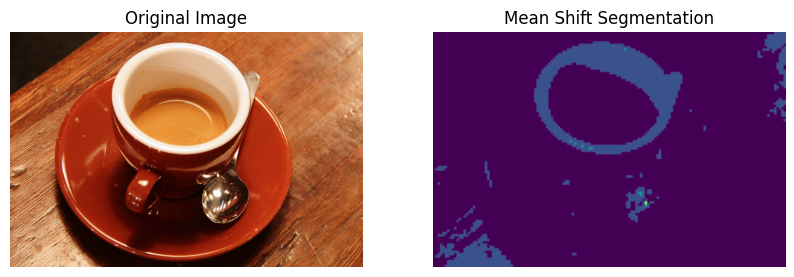

In [ ]:
# Reshape the labels to a 2D array
labels_2d = labels.reshape(image_hsv.shape[:-1])

# Plot the original image and the segmented image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image_rgb)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(labels_2d)
plt.title('Mean Shift Segmentation')
plt.axis('off')


plt.show()


## Felzenszwalb-Huttenlocher

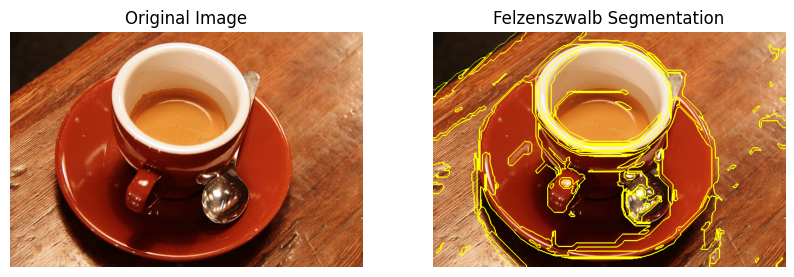

In [ ]:

import skimage.data
import skimage.segmentation
import matplotlib.pyplot as plt

# Load the image
image = skimage.data.coffee()

# Perform Felzenszwalb segmentation
segments = skimage.segmentation.felzenszwalb(image, scale=100, sigma=4)

# Mark the boundaries of the segments
boundaries = skimage.segmentation.mark_boundaries(image, segments)

# Show the original image and the segmented image with boundaries
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(boundaries)
plt.title('Felzenszwalb Segmentation')
plt.axis('off')

plt.show()


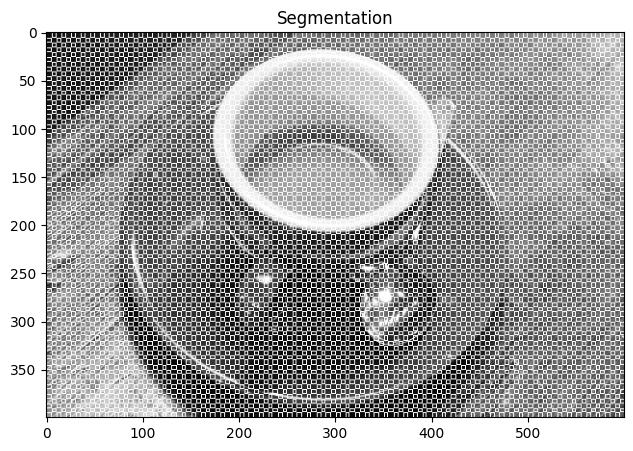

In [ ]:
, # prompt: Using skimage, compute the segments using Chan-vese for max_num_iter = [1,30]. Generate a GIF animation with the results of each max_num_iter.
from matplotlib import rc
rc('animation', html='jshtml')

import skimage.data
import skimage.filters
import skimage.segmentation
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Load the image
image = skimage.data.coffee()
image = skimage.color.rgb2gray(image)

# Initialize the Chan-Vese model

# Compute the segmentation for different max_num_iter values
segmentations = []
STEP_SIZE = 5
NUM_STEPS = 30*STEP_SIZE
for max_num_iter in range(0, NUM_STEPS, STEP_SIZE):
    segments_cv = skimage.segmentation.chan_vese(image, max_num_iter=max_num_iter)
    boundaries_cv = skimage.segmentation.mark_boundaries(image, segments_cv)

    segmentations.append(boundaries_cv[:,:,0])

# Create a figure and subplots for the animation
fig, ax = plt.subplots(1, 1, figsize=(8, 5))

# Define the animation function
def animate(i):
    ax.imshow(segmentations[i], cmap="gray")
    ax.set_title("Segmentation")

# Create the animation
anim = animation.FuncAnimation(fig, animate, frames=len(segmentations), interval=500)
anim.save("chan-vese.gif")
anim

## Como Comparar?

(-0.5, 383.5, 302.5, -0.5)

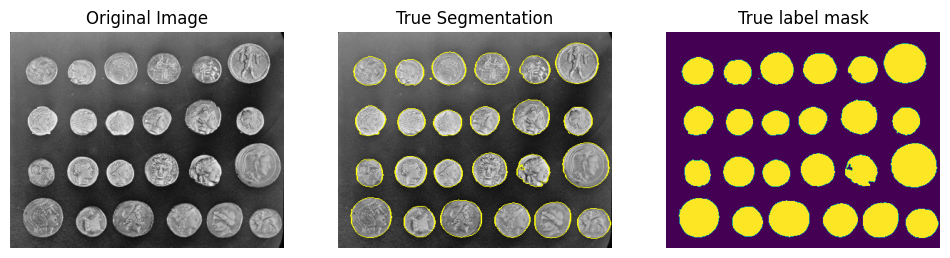

In [ ]:
from scipy import ndimage as ndi

from skimage import data
from skimage.metrics import adapted_rand_error, variation_of_information
from skimage.filters import sobel
from skimage.measure import label
from skimage.util import img_as_float
from skimage.feature import canny
from skimage.morphology import remove_small_objects
from skimage.segmentation import (
    morphological_geodesic_active_contour,
    inverse_gaussian_gradient,
    watershed,
    mark_boundaries,
)

import numpy as np


image = skimage.data.coins()


elevation_map = sobel(image)
markers = np.zeros_like(image)
markers[image < 30] = 1
markers[image > 150] = 2
label_true = watershed(elevation_map, markers).astype(int) - 1

plt.figure(figsize=(12, 5))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap = 'gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
boundaries_true = skimage.segmentation.mark_boundaries(image, label_true)
plt.imshow(boundaries_true)

plt.title('True Segmentation')
plt.axis('off')

plt.subplot(1, 3, 3)
boundaries_true = skimage.segmentation.mark_boundaries(image, label_true)
plt.imshow(label_true)

plt.title('True label mask')
plt.axis('off')


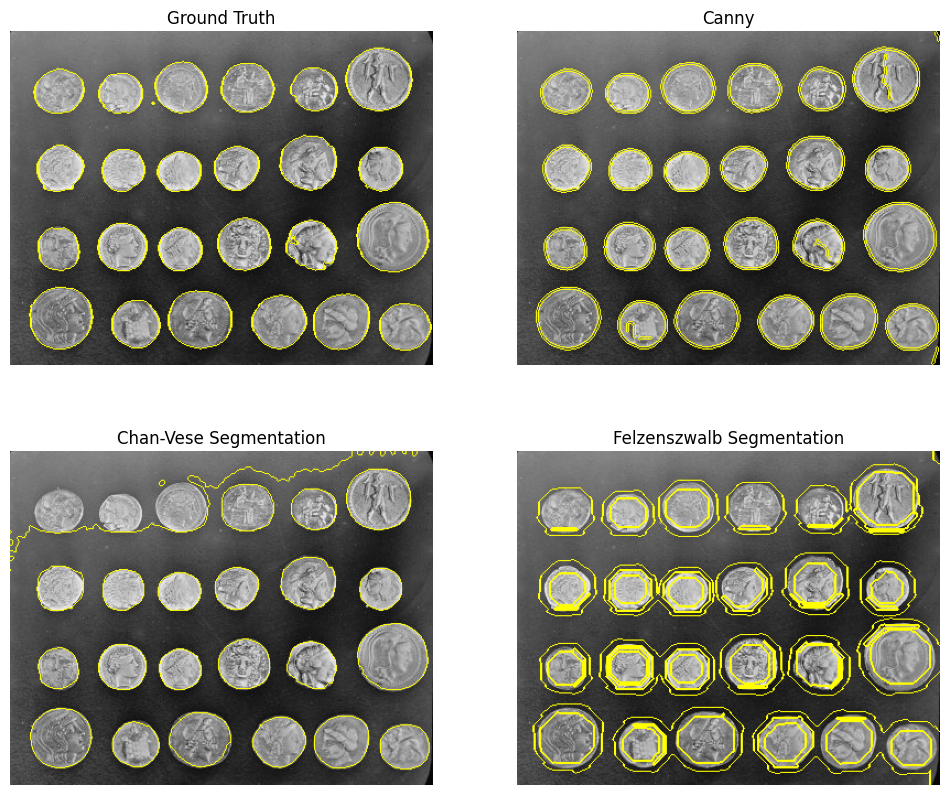

In [ ]:
# prompt: Compare the quick shift and the felzenszwalb segmentation, showing the boundaries of each

import matplotlib.pyplot as plt
# Load the image
image = skimage.data.coffee()
image = skimage.data.coins()

# Perform chan_vese segmentation
segments_cv = skimage.segmentation.chan_vese(image)

# Mark the boundaries of the segments
boundaries_cv = skimage.segmentation.mark_boundaries(image, segments_cv)


# Canny
segments_canny = skimage.feature.canny(image, sigma=3)
boundaries_canny = mark_boundaries(image, segments_canny)

# Perform Felzenszwalb segmentation
segments_fz = skimage.segmentation.felzenszwalb(image, scale=100, sigma=4)

# Mark the boundaries of the segments
boundaries_fz = skimage.segmentation.mark_boundaries(image, segments_fz)

# Show the original image and the segmented images with boundaries
plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.imshow(boundaries_true)
plt.title('Ground Truth')
plt.axis('off')

# Show the original image and the segmented images with boundaries
plt.subplot(2,2, 2)
plt.imshow(boundaries_canny)
plt.title('Canny')
plt.axis('off')

plt.subplot(2,2, 3)
plt.imshow(boundaries_cv)
plt.title('Chan-Vese Segmentation')
plt.axis('off')

plt.subplot(2,2, 4)
plt.imshow(boundaries_fz)
plt.title('Felzenszwalb Segmentation')
plt.axis('off')

plt.show()


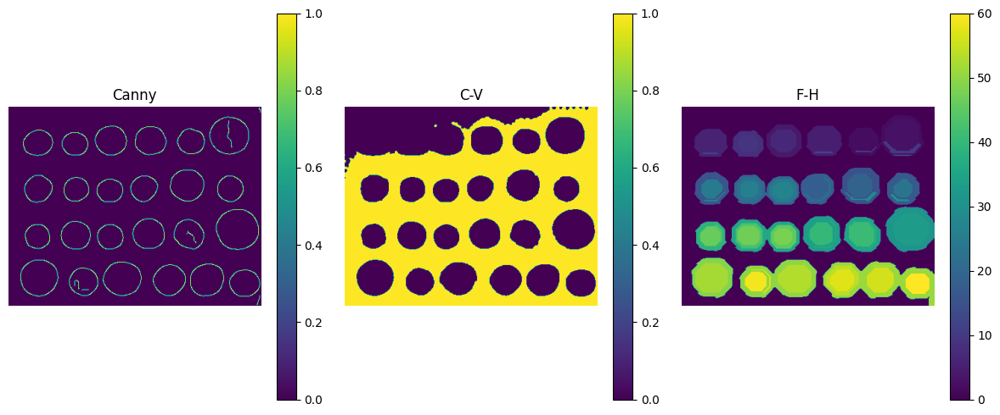

In [ ]:
fig = plt.figure(figsize=(12, 5))
plt.subplot(1,3,1)
plt.imshow(segments_canny)
plt.title('Canny')
plt.axis('off')
plt.colorbar()

plt.subplot(1,3,2)
plt.imshow(segments_cv)
plt.title('C-V')
plt.axis('off')
plt.colorbar()


plt.subplot(1,3,3)
plt.imshow(segments_fz)
plt.title('F-H')
plt.axis('off')
plt.colorbar()

plt.tight_layout()
plt.show()

In [ ]:
# adjusting label masks to compute metrics

segments_cv_bin = segments_cv.copy().astype(int)
segments_cv_bin[segments_cv_bin == 0] = 2
segments_cv_bin[segments_cv_bin == 1] = 0
segments_cv_bin[segments_cv_bin == 2] = 1

segments_fz_bin = segments_fz.copy()
segments_fz_bin[segments_fz_bin > 0] = 1

segments_canny_bin = segments_canny.copy().astype(int)
segments_canny_bin = ndi.binary_fill_holes(segments_canny_bin).astype(int)


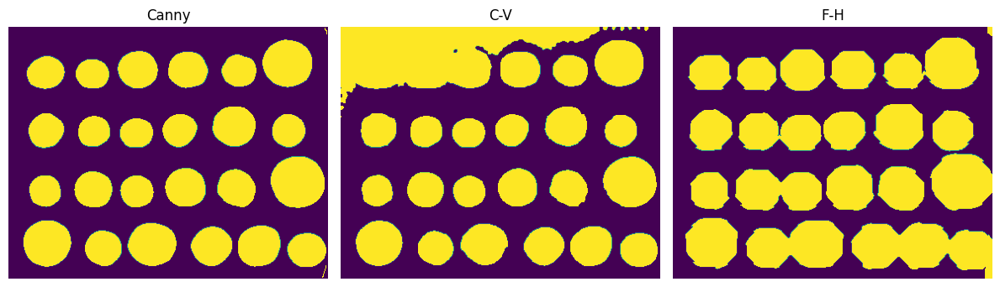

In [ ]:
fig = plt.figure(figsize=(12, 5))
plt.subplot(1,3,1)
plt.imshow(segments_canny_bin)
plt.title('Canny')
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(segments_cv_bin)
plt.title('C-V')
plt.axis('off')


plt.subplot(1,3,3)
plt.imshow(segments_fz_bin)
plt.title('F-H')
plt.axis('off')

plt.tight_layout()
plt.show()

MAE CV
0.11188462596259625
MAE Canny
0.016071919691969198


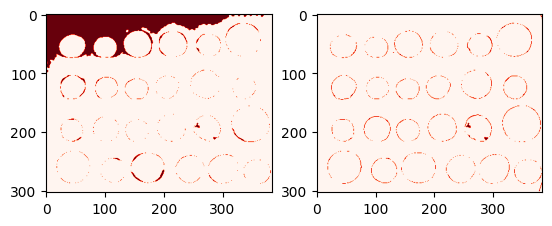

In [ ]:
diff_img_cv = np.abs(segments_cv_bin - label_true)
diff_img_canny = np.abs(segments_canny_bin - label_true)

plt.subplot(1,2,1)
plt.imshow(diff_img_cv, cmap = 'Reds')
plt.subplot(1,2,2)
plt.imshow(diff_img_canny, cmap = 'Reds')

print('MAE CV')
print(diff_img_cv.mean())
print('MAE Canny')
print(diff_img_canny.mean())

### Métricas

- MSE/MAE
- IoU

<img src = "https://b2633864.smushcdn.com/2633864/wp-content/uploads/2016/09/iou_equation.png?lossy=2&strip=1&webp=1" width=300>

In [ ]:
from sklearn.metrics import jaccard_score as iou_score

names = ['Canny', 'C-V', 'F-H']
for name, seg_bin in zip(names, [segments_canny_bin, segments_cv_bin, segments_fz_bin]):
    iou = iou_score(label_true, seg_bin, average = 'micro')
    print(f'{name} IoU score: {iou:.3f}')

    diff_img = (seg_bin.astype(int) - label_true).astype(int)
    mae = np.mean(np.abs(diff_img))
    print(f'{name} MAE: {mae:.3f}\n')

Canny IoU score: 0.954
Canny MAE: 0.016

C-V IoU score: 0.747
C-V MAE: 0.112

F-H IoU score: 0.702
F-H MAE: 0.142



# Rotulação

## Descritores morfológicos

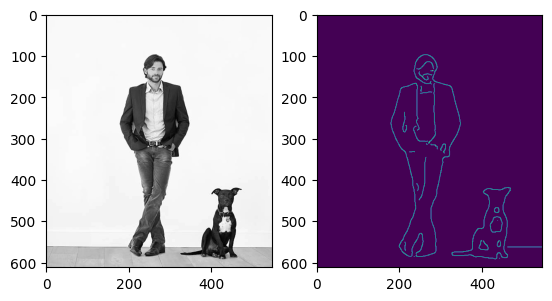

In [ ]:
# prompt: using skimage, open the art8.gif image and apply the connected components labling, show the results.

import skimage
import matplotlib.pyplot as plt
from skimage.color import label2rgb
import scipy.ndimage as ndi
from skimage.segmentation import mark_boundaries



# Load the image
image = skimage.io.imread('person_dog.jpg')
image = skimage.color.rgb2gray(image)

segments_canny = skimage.feature.canny(image, sigma=4)
boundaries_canny = mark_boundaries(image, segments_canny)

segments_canny_bin = segments_canny.copy().astype(int)
#segments_canny_bin = ndi.binary_fill_holes(segments_canny_bin).astype(int)

plt.subplot(1,2,1)
plt.imshow(image, cmap = 'gray')
plt.subplot(1,2,2)
plt.imshow(segments_canny_bin)
plt.show()


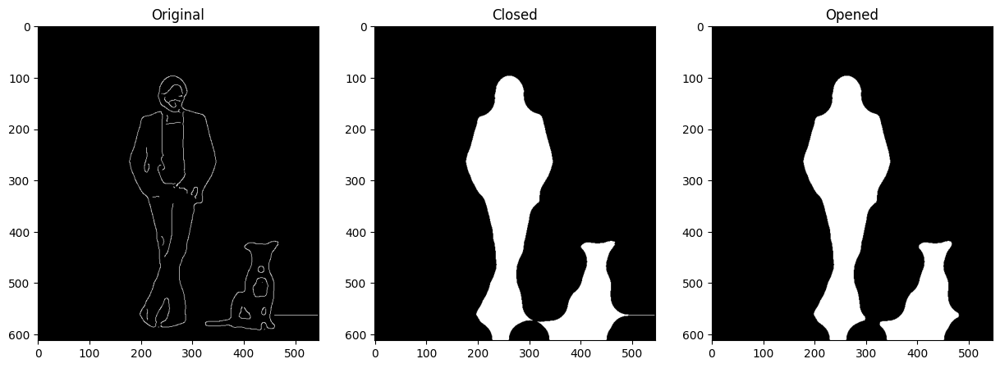

In [ ]:
# prompt: using skimage, perform morphological closing of segments_canny_bin, then opening, show results

import matplotlib.pyplot as plt
from skimage.morphology import binary_closing, binary_opening

# Perform morphological closing
segments_canny_bin_closed = binary_closing(segments_canny_bin, skimage.morphology.disk(35))

# Perform morphological opening
segments_canny_bin_opened = binary_opening(segments_canny_bin_closed, skimage.morphology.disk(5))

# Show the results
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(segments_canny_bin, cmap="gray")
axs[0].set_title("Original")
axs[1].imshow(segments_canny_bin_closed, cmap="gray")
axs[1].set_title("Closed")
axs[2].imshow(segments_canny_bin_opened, cmap="gray")
axs[2].set_title("Opened")
plt.show()


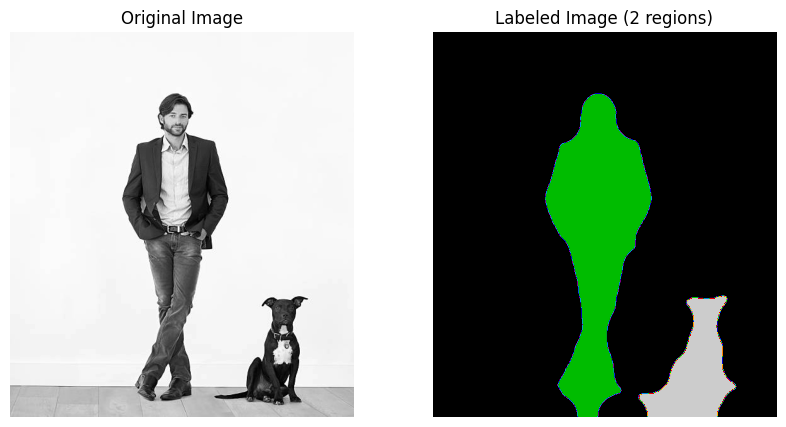

In [ ]:

# Apply connected components labeling
label_image, num_regions = skimage.measure.label(segments_canny_bin_opened,  return_num=True)
image_label_overlay = label2rgb(label_image, image=image, bg_label=0)

# Display the original image and the labeled image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(label_image, cmap='nipy_spectral')
plt.title(f'Labeled Image ({num_regions} regions)')
plt.axis('off')

plt.show()

Area: 45477
Minimum dimension: 134.85
Maximum dimension: 527.50
Area: 14709
Minimum dimension: 109.81
Maximum dimension: 222.02


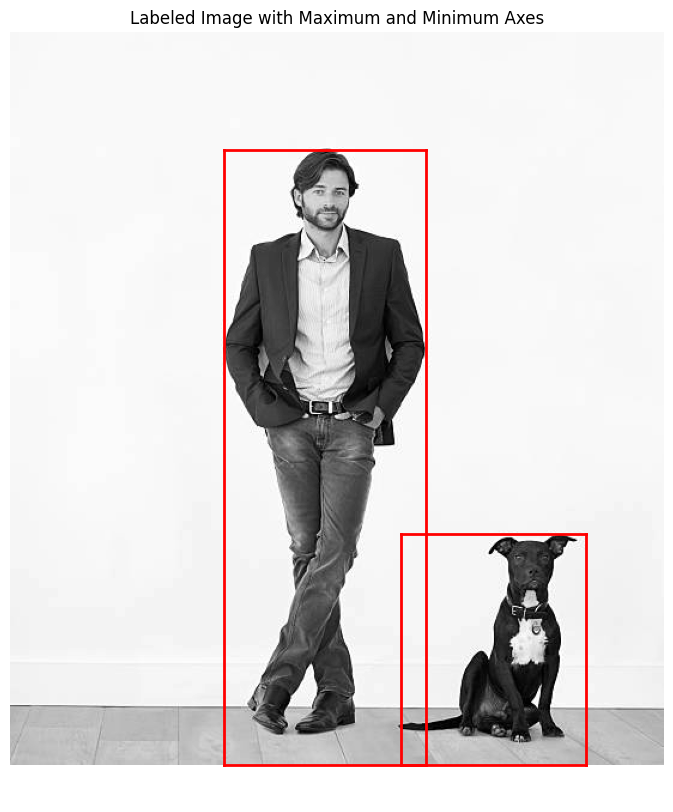

In [ ]:
# prompt: using skimage, compute the area and the maximum/minimum dimension of the labeled regions. Plot the maximum and minimum axes on the image.

import matplotlib.pyplot as plt
import skimage.measure as measure

# Compute the area and the maximum/minimum dimension of the labeled regions
regions = measure.regionprops(label_image)

# Plot the maximum and minimum axes on the image
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(image, cmap="gray")

# prompt: using skimage, compute the area and the maximum/minimum dimension of the labeled regions.

import skimage.measure

# Compute the area and the maximum/minimum dimension of the labeled regions
regions = skimage.measure.regionprops(label_image)

for region in regions:
    print(f"Area: {region.area}")
    print(f"Minimum dimension: {region.minor_axis_length:.2f}")
    print(f"Maximum dimension: {region.major_axis_length:.2f}")


    min_row, min_col, max_row, max_col = region.bbox
    ax.plot((min_col, max_col), (min_row, min_row), color="r", linewidth=2)
    ax.plot((min_col, max_col), (max_row, max_row), color="r", linewidth=2)
    ax.plot((min_col, min_col), (min_row, max_row), color="r", linewidth=2)
    ax.plot((max_col, max_col), (min_row, max_row), color="r", linewidth=2)

ax.set_title("Labeled Image with Maximum and Minimum Axes")
ax.axis("off")
plt.show()


## Momentum e Central Momentum

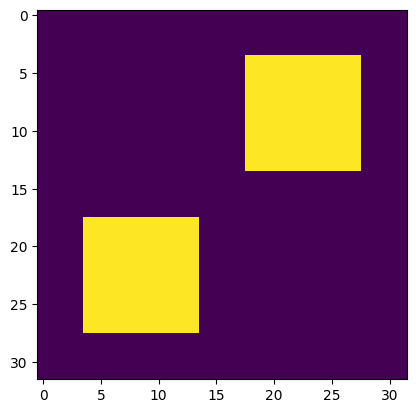

In [ ]:
img_sq = np.zeros((32,32))
region_limits = [[[4,14], [18,28]], [[18,28], [4,14]]]

img_sq[4:14, 18:28] = 1
img_sq[18:28, 4:14] = 1

ax = plt.subplot()
ax.set_aspect('equal')
ax.imshow(img_sq)

In [ ]:
def momentum(image, y1,y2,x1,x2, order = [0,0]):
    acum = 0
    for row in range(y1,y2):
        for col in range(x1,x2):
            acum += (row**(order[0])) * (col**(order[1])) * image[row,col]
    return acum

def central_momentum(image, y1,y2,x1,x2, cy, cx, order = [0,0]):
    acum = 0
    for row in range(y1,y2):
        for col in range(x1,x2):
            acum += ((row-cy)**(order[0])) * ((col-cx)**(order[1])) * image[row,col]
    return acum


for region_limit in region_limits:
    [y1,y2],[x1,x2] = region_limit
    m00 = momentum(img_sq, y1,y2,x1,x2, order = [0,0])
    m01 = momentum(img_sq, y1,y2,x1,x2, order = [0,1])
    m10 = momentum(img_sq, y1,y2,x1,x2, order = [1,0])
    centroid_y = m10/m00
    centroid_x = m01/m00

    print(f'Area: {m00}, Cx: {centroid_y}, Cy:{centroid_x}')

    # m02 = momentum(img_sq, y1,y2,x1,x2, order = [0,2])
    # m20 = momentum(img_sq, y1,y2,x1,x2, order = [2,0])

    m02 = central_momentum(img_sq, y1,y2,x1,x2, centroid_y, centroid_x, order = [0,2])
    m20 = central_momentum(img_sq, y1,y2,x1,x2, centroid_y, centroid_x, order = [2,0])

    print(f'2nd order momemnts: {m02,m20}')


Area: 25.0, Cx: 11.0, Cy:25.0
2nd order momemnts: (50.0, 50.0)
Area: 25.0, Cx: 25.0, Cy:11.0
2nd order momemnts: (50.0, 50.0)


## HoG

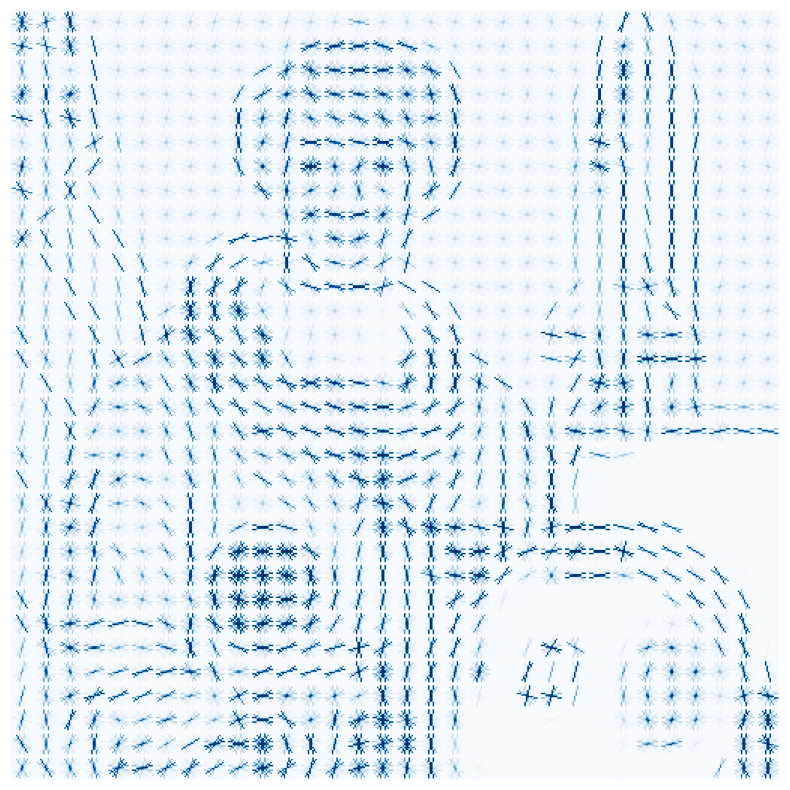

In [ ]:
# prompt: using skimage, open the coffee image and generate its HoG features. Plot the HoG results onto the image.

import skimage
from skimage.feature import hog
from skimage import data
import matplotlib.pyplot as plt
from skimage import exposure

# Load the coffee image
image = skimage.data.astronaut()

# Compute the HoG features
fd, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1,1), visualize=True, channel_axis = 2)

hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

# Print the shape of the features
# Plot the HoG features
plt.figure(figsize=(10, 10))
plt.imshow(image)
#hog_image_rescaled[hog_image_rescaled == 0] = None
plt.imshow(hog_image_rescaled, cmap="Blues")
plt.axis("off")
plt.show()


## SIFT

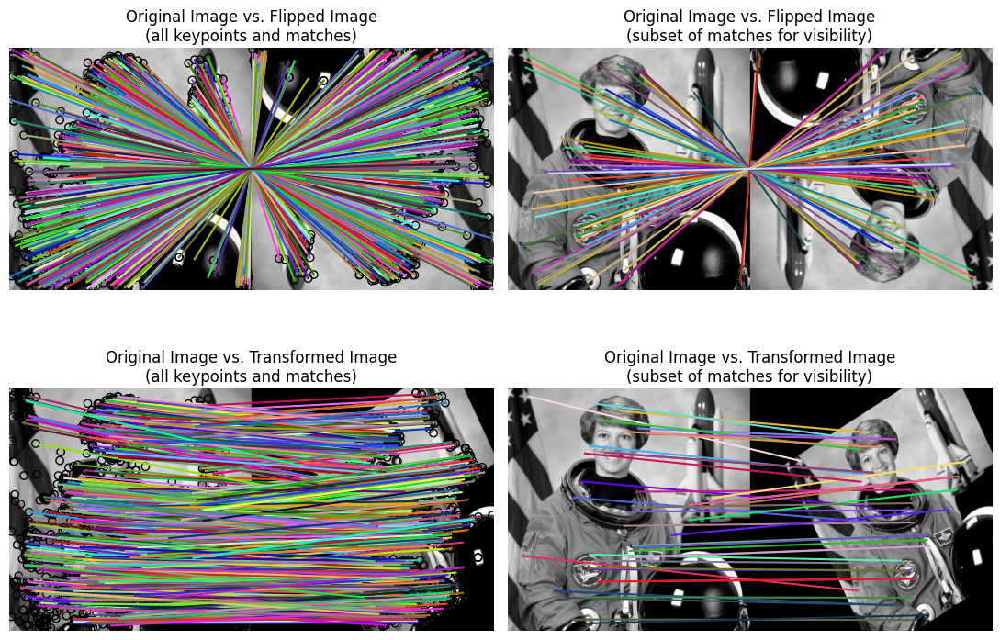

In [ ]:
import matplotlib.pyplot as plt

from skimage import data
from skimage import transform
from skimage.color import rgb2gray
from skimage.feature import match_descriptors, plot_matches, SIFT

img1 = rgb2gray(data.astronaut())
img2 = transform.rotate(img1, 180)
tform = transform.AffineTransform(scale=(1.3, 1.1), rotation=0.5, translation=(0, -200))
img3 = transform.warp(img1, tform)

descriptor_extractor = SIFT()

descriptor_extractor.detect_and_extract(img1)
keypoints1 = descriptor_extractor.keypoints
descriptors1 = descriptor_extractor.descriptors

descriptor_extractor.detect_and_extract(img2)
keypoints2 = descriptor_extractor.keypoints
descriptors2 = descriptor_extractor.descriptors

descriptor_extractor.detect_and_extract(img3)
keypoints3 = descriptor_extractor.keypoints
descriptors3 = descriptor_extractor.descriptors

matches12 = match_descriptors(
    descriptors1, descriptors2, max_ratio=0.6, cross_check=True
)
matches13 = match_descriptors(
    descriptors1, descriptors3, max_ratio=0.6, cross_check=True
)
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(11, 8))

plt.gray()

plot_matches(ax[0, 0], img1, img2, keypoints1, keypoints2, matches12)
ax[0, 0].axis('off')
ax[0, 0].set_title("Original Image vs. Flipped Image\n" "(all keypoints and matches)")

plot_matches(ax[1, 0], img1, img3, keypoints1, keypoints3, matches13)
ax[1, 0].axis('off')
ax[1, 0].set_title(
    "Original Image vs. Transformed Image\n" "(all keypoints and matches)"
)

plot_matches(
    ax[0, 1], img1, img2, keypoints1, keypoints2, matches12[::15], only_matches=True
)
ax[0, 1].axis('off')
ax[0, 1].set_title(
    "Original Image vs. Flipped Image\n" "(subset of matches for visibility)"
)

plot_matches(
    ax[1, 1], img1, img3, keypoints1, keypoints3, matches13[::15], only_matches=True
)
ax[1, 1].axis('off')
ax[1, 1].set_title(
    "Original Image vs. Transformed Image\n" "(subset of matches for visibility)"
)

plt.tight_layout()
plt.show()


## Aplicando HoG para detecção



In [ ]:
from sklearn.datasets import fetch_openml

# Load the Fashion MNIST dataset
mnist = fetch_openml('Fashion-MNIST', version=1)

/usr/local/lib/python3.10/dist-packages/sklearn/datasets/_openml.py:968: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


In [ ]:
 mnist["target"].value_counts()

class
0    7000
1    7000
2    7000
3    7000
4    7000
5    7000
6    7000
7    7000
8    7000
9    7000
Name: count, dtype: int64

5


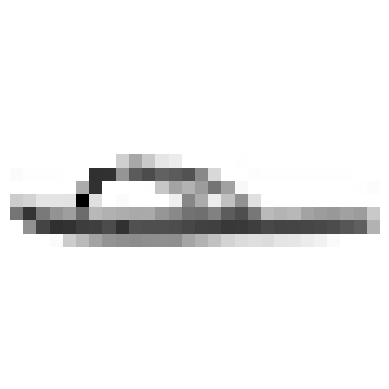

In [ ]:
idx = 30
img = mnist["data"].values[idx].reshape(28, 28)
print(mnist["target"][idx])

plt.imshow(img, cmap="binary")
plt.axis("off")
plt.show()

In [ ]:
# prompt: generate the HoG features for each image. Save the features as Xhog

import numpy as np
from skimage.feature import hog

# Extract the data and target labels
X, y = mnist["data"], mnist["target"]

# Normalize the data
X = np.array(X.values) / 255.0

# Compute the HoG features for each image
Xhog = []
for i in range(len(X)):
  # traduz 784 -> 28x28
  tmp = X[i].reshape(28,28)
  fd = hog(tmp, orientations=8, pixels_per_cell=(8, 8),
                    cells_per_block=(1, 1), visualize=False, feature_vector = True)
  Xhog.append(fd)

# Convert the features to a NumPy array
Xhog = np.array(Xhog)

print(Xhog.shape)


(70000, 72)


In [ ]:
# prompt: Train an SVM classifier using Xhog as feature

from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(Xhog, y, test_size=0.2, random_state=42)

# Train the SVM classifier
clf = SVC(kernel='linear', C=1.0)
clf.fit(X_train, y_train)

# Evaluate the classifier on the test set
score = clf.score(X_test, y_test)
print(f"Test score: {score:.3f}")


Test score: 0.794


In [ ]:
# prompt: load the fashion MNIST data set, extract HoG features and train an SVM using these features.

import numpy as np
import sklearn.svm as svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from skimage.feature import hog

_X, _y = mnist["data"], mnist["target"]
_X = np.asarray(_X)
_y = _y.astype(int)

X = _X[_y < 3]
y = _y[_y < 3]

X_hog = []

# Extract HoG features
for img_idx in range(X.shape[0]):
    img = X[img_idx].reshape(28,28)
    hog_img =  hog(img, orientations=8, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualize=False, feature_vector=True)
    X_hog.append(hog_img)

X_hog = np.array(X_hog)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_hog, y, test_size=0.3, random_state=42)

# Train an SVM classifier
clf = svm.SVC(kernel='linear', C=1.0)
clf.fit(X_train, y_train)

# Evaluate the classifier on the testing set
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)

# Print the accuracy
print("Accuracy:", accuracy)


Accuracy: 0.9398412698412698
